# Overview of digitised books

````{card}
On this page
```{contents}
:local:
```
````

## Finding digitised books

Trove includes thousands of digitised resources described as books. You can find them by using the [standard search strategy for digitised resources](/understanding-search/finding-digitised-content) – search for `"nla.obj"` in the **Books & Libraries** category with the `availability` facet set to `y`, and the `format` facet set to `Book`.

[![Try it!](https://troveconsole.herokuapp.com/static/img/try-trove-api-console.svg)](https://troveconsole.herokuapp.com/v3/?url=https%3A%2F%2Fapi.trove.nla.gov.au%2Fv3%2Fresult%3Fq%3D%22nla.obj%22%26category%3Dbook%26l-availability%3Dy%26l-format%3DBook%26encoding%3Djson&comment=)

You might want to filter these results further, for example:

- exclude books that are not freely available online by setting the `availability` facet to `y/f` – this should exclude books uploaded through the National E-Deposit scheme which can only be accessed onsite
- exclude all books uploaded through the National E-Deposit scheme by adding `NOT nuc:"ANL:NED"` to your query
- exclude Parliamentary Papers by adding `NOT series:"Parliamentary paper (Australia. Parliament)"` to your query

You'd expect all the books to be in the **Books & Libraries** category, but keeping in mind the basic principle to ['always assume that Trove isn't telling you everything'](search-is-a-research-method), you might want to look for books in other categories as well. If you're using the API this is easy to do by setting `category` to `all` and `bulkHarvest` to `true`.

[![Try it!](https://troveconsole.herokuapp.com/static/img/try-trove-api-console.svg)](https://troveconsole.herokuapp.com/v3/?url=https%3A%2F%2Fapi.trove.nla.gov.au%2Fv3%2Fresult%3Fq%3D%22nla.obj%22%26category%3Dall%26l-availability%3Dy%26l-format%3DBook%26bulkHarvest%3Dtrue%26encoding%3Djson&comment=)

## How many digitised books are there?

I've created a dataset of digitised books in Trove by using the basic search strategy outined above and excluding Parliamentary Papers. Harvesting data about digitised resoures is tricky because of the way they're described and grouped. To workaround these problems, I used the method described in [](/other-digitised-resources/how-to/harvest-digitised-resources) to process all versions, exclude records without a `fulltext` identifier, add in multi-volume works and other collection groupings, and merge duplicate records using their `fulltext` identifier. I then attempted to download OCRd text from the books. The [resulting dataset](https://github.com/GLAM-Workbench/trove-books-data/blob/main/trove-books.csv) is available on GitHub.

You can use this dataset to investigate the characteristics of Trove's digitised books. For example, how many book records are there in the dataset?

In [4]:
import altair as alt
import pandas as pd
from IPython.display import HTML
from myst_nb import glue

alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [6]:
import pandas as pd

df = pd.read_csv(
    "https://raw.githubusercontent.com/GLAM-Workbench/trove-books-data/main/trove-books.csv",
    keep_default_na=False,
)

print(f"There are {df.shape[0]:,} book records!")

There are 21,218 book records!


How many of the books have OCRd text you can download?

In [8]:
print(f"{df.loc[df['text_file'] != ''].shape[0]:,}")

17,692


Why wouldn't a digitised book have OCRd text? I suspect it's because some of the so-called books are actually leaflets and posters. There are probably also some NED books in PDF or eBook formats.

## What languages are they in?

The book metadata includes a `language` field. This field can have multiple values.

How many different languages are recorded in the `language` field?

In [10]:
languages = df["language"].str.split(" | ", regex=False).explode()

languages.nunique()

251

What are the ten most common `language` values?

In [12]:
languages.value_counts().to_frame().reset_index()[:10].style.format(
    thousands=","
).hide()

language,count
English,"17,903"
Chinese,"1,685"
,518
French,256
Undetermined,162
German,132
Japanese,95
Italian,89
Austronesian (Other),80
Dutch,77


It's no suprise that a large majority of the books are in English. To dig deeper, uou can exclude the English books and visualise the remaining language counts as a word cloud.

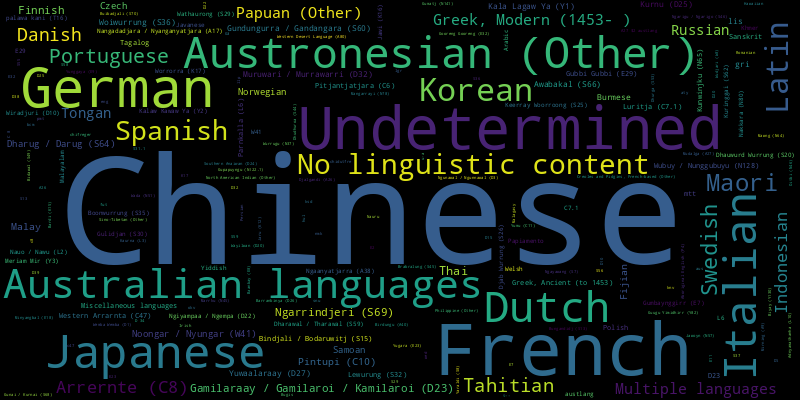

In [14]:
from wordcloud import WordCloud

language_counts = languages.value_counts().to_dict()
del language_counts["English"]

wc = WordCloud(width=800, height=400)
wc.generate_from_frequencies(language_counts)
language_cloud = wc.to_image()
display(language_cloud)

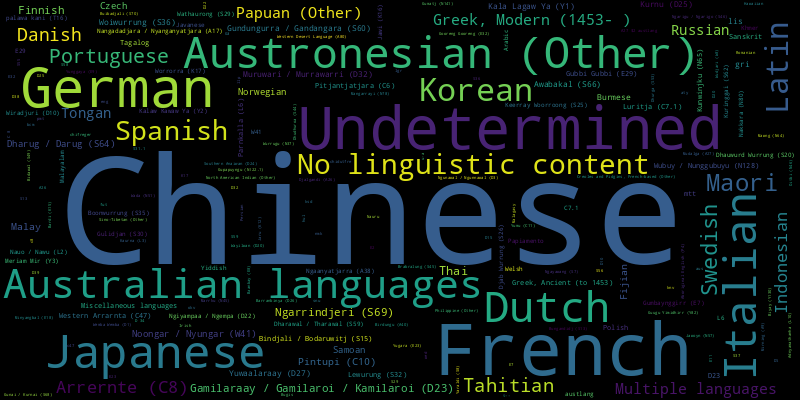

In [15]:
glue("language_cloud", language_cloud)

```{glue:figure} language_cloud
:name: books-language-cloud

Languages of digitised books (excluding English)
```

## When were they published?

You can use the `date` field to examine their publication dates.

In [28]:
import altair as alt

df["year"] = df["date"].str.extract(r"\b((?:16|17|18|19|20)\d{2})\b")
year_counts = df["year"].value_counts().to_frame().reset_index()

chart_years = alt.Chart(year_counts).mark_bar(size=1).encode(
    x="year:T",
    y=alt.Y("count:Q", title="number of books"),
    tooltip=[alt.Tooltip("year:T", format="%Y"), "count:Q"],
).properties(width="container", height=200, padding=20)

display(chart_years)

alt.Chart(...)

In [ ]:
glue("chart_years", chart_years)

```{glue:figure} chart_years
:name: chart-years
Publication years of digitised books
```

Why are there peaks in 1800, 1900, 2000? Presumably because an exact publication date was not known, so a value for the century was used.

## What is the copyright status?

The `rights` field includes information about copyright. This field can have multiple values, and often there'll be both string value and a url.

In [29]:
df["rights"].str.split(
    " | ", regex=False
).explode().value_counts().to_frame().reset_index().style.format(thousands=",").hide()

rights,count
http://rightsstatements.org/vocab/NKC/1.0/,"17,300"
Out of Copyright,"15,848"
No known copyright restrictions,"4,492"
,433
In Copyright,397
Perpetual,46
Mixed copyright,2
Out of copyright,2
http://creativecommons.org/licenses/by-nc-nd/3.0/au,1


## What are they about?

The `subject` field contains standard(ish) subject headings. There can be multiple values. The values below have been normalised to standardise spacing and remove trailing full stops.

In [36]:
import re

def split_and_clean(value):
    values = value.split("|")
    return list(
        set(
            [
                re.sub(r"(\w)--(\w)", r"\1 -- \2", v).strip().strip(".")
                for v in values
                if v
            ]
        )
    )


df["subjects"] = df["subject"].apply(split_and_clean)

subjects = df["subjects"].explode().to_frame()

subjects["subjects"].value_counts().to_frame().reset_index()[:20].style.format(
    thousands=","
).hide()

subjects,count
Australian,"3,457"
Printed ephemera -- Australia,"2,090"
Menus -- Specimens,963
Chinese language -- Dictionaries,610
"Menus - Shipping (general, Orient, P&O)",480
Menus -- Australia -- Specimens,470
Invitation cards -- Australia,423
Programs -- Australia,419
Australia,369
Menus - General,335


## How many pages do they contain?

The number of pages is generally not in the API data, but I've extracted it from the metadata embedded in the digitised book viewer. This number really represents the number of digitised images, so it can include covers and endleaves.

How many digitised pages (or images) are there in total?

In [32]:
print(f"{df['pages'].sum():,}")

1,473,337


By 'binning' the page values into groups of 100 you can examine how the page lengths vary.

In [35]:
chart_pages = alt.Chart(df).mark_bar().encode(
    x=alt.X("pages:Q", title="number of pages (binned)").bin(maxbins=20), 
    y=alt.Y("count()", title="number of books")
).properties(
    width="container", height=200
)

display(chart_pages)

alt.Chart(...)

In [ ]:
glue("chart_pages", chart_pages)

```{glue:figure} chart_pages
:name: chart-pages
Number of pages in digitised books (binned)
```

Why are most of the books less than 100 pages long? if you look at the list above of the most common subjects, you'll see that a number of them relate to 'ephemera'. It seems thata significant number of Trove's 'books' are actually things like leaflets, pamphlets, posters, and menus.

What's the longest book?

In [100]:
df.loc[df["pages"].idxmax()]

title                                   Jiu xin yue quan shu. | 舊新約全書.
sub_unit                                                              
contributor          British and Foreign Bible Society | British an...
publisher            Sheng shu gong hui | [Guangzhou] : Sheng shu g...
date                                                              1907
type                                                                  
format                                                            Book
extent                         1308, 400 pages ; 23 cm. | 703718 words
language                                                       Chinese
subject                                                               
spatial                                                               
is_part_of                                                            
identifier           AuCNLKIN: 000015575462 | LMS 545 | OCoLC: 2224...
rights               No known copyright restrictions | http://right...
pages 